In [1]:
import torch
import pandas as pd
import numpy as np
import folium
from folium.plugins import MarkerCluster
import matplotlib.pyplot as plt
import seaborn as sns
import copy
import warnings
warnings.filterwarnings("ignore")

print(torch.cuda.is_available())
print(torch.cuda.get_device_name(0)) 

True
NVIDIA GeForce RTX 3090 Ti


In [178]:
# Converting csv data into dataframe
df = pd.read_csv('data/perth_house_prices.csv')
df.columns = df.columns.str.lower()
pd.options.display.float_format = '{:.0f}'.format
df.head(10)

,address,suburb,price,bedrooms,bathrooms,garage,land_area,floor_area,build_year,cbd_dist,nearest_stn,nearest_stn_dist,date_sold,postcode,latitude,longitude,nearest_sch,nearest_sch_dist,nearest_sch_rank
0,1 Acorn Place,South Lake,565000,4,2,2,600,160,2003,18300,Cockburn Central Station,1800,09-2018\r,6164,-32,116,LAKELAND SENIOR HIGH SCHOOL,1,NaN
1,1 Addis Way,Wandi,365000,3,2,2,351,139,2013,26900,Kwinana Station,4900,02-2019\r,6167,-32,116,ATWELL COLLEGE,6,129
2,1 Ainsley Court,Camillo,287000,3,1,1,719,86,1979,22600,Challis Station,1900,06-2015\r,6111,-32,116,KELMSCOTT SENIOR HIGH SCHOOL,2,113
3,1 Albert Street,Bellevue,255000,2,1,2,651,59,1953,17900,Midland Station,3600,07-2018\r,6056,-32,116,SWAN VIEW SENIOR HIGH SCHOOL,2,NaN
4,1 Aman Place,Lockridge,325000,4,1,2,466,131,1998,11200,Bassendean Station,2000,11-2016\r,6054,-32,116,KIARA COLLEGE,2,NaN
5,1 Amethyst Crescent,Mount Richon,409000,4,2,1,759,118,1991,27300,Armadale Station,1000,03-2013\r,6112,-32,116,ARMADALE SENIOR HIGH SCHOOL,1,NaN
6,1 Ardara Lane,Hilbert,400000,3,2,2,386,132,2014,28200,Armadale Station,3700,05-2016\r,6112,-32,116,DALE CHRISTIAN SCHOOL,2,NaN
7,1 Arnside Bend,Waikiki,370000,4,2,2,468,158,2013,41700,Warnbro Station,1100,03-2019\r,6169,-32,116,SOUTH COAST BAPTIST COLLEGE,0,NaN
8,1 Arrochar Court,Hamersley,565000,4,2,3,875,168,1983,12100,Warwick Station,2500,06-2020\r,6022,-32,116,WARWICK SENIOR HIGH SCHOOL,1,NaN
9,1 Arundel Street,Bayswater,685000,3,2,8,552,126,1999,5900,Bayswater Station,508,10-2019\r,6053,-32,116,CHISHOLM CATHOLIC COLLEGE,1,29


In [179]:
# Checking information on all columns 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33656 entries, 0 to 33655
Data columns (total 19 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   address           33656 non-null  object 
 1   suburb            33656 non-null  object 
 2   price             33656 non-null  int64  
 3   bedrooms          33656 non-null  int64  
 4   bathrooms         33656 non-null  int64  
 5   garage            31178 non-null  float64
 6   land_area         33656 non-null  int64  
 7   floor_area        33656 non-null  int64  
 8   build_year        30501 non-null  float64
 9   cbd_dist          33656 non-null  int64  
 10  nearest_stn       33656 non-null  object 
 11  nearest_stn_dist  33656 non-null  int64  
 12  date_sold         33656 non-null  object 
 13  postcode          33656 non-null  int64  
 14  latitude          33656 non-null  float64
 15  longitude         33656 non-null  float64
 16  nearest_sch       33656 non-null  object

In [180]:
# Show number of null values per column
print(df.isnull().sum())

address                 0
suburb                  0
price                   0
bedrooms                0
bathrooms               0
garage               2478
land_area               0
floor_area              0
build_year           3155
cbd_dist                0
nearest_stn             0
nearest_stn_dist        0
date_sold               0
postcode                0
latitude                0
longitude               0
nearest_sch             0
nearest_sch_dist        0
nearest_sch_rank    10952
dtype: int64


In [181]:
# Number of unique values for categorical location column
print(df['address'].nunique())
print(df['suburb'].nunique())

33566
321


In [182]:
# Checking basic descriptions of our dataset
df.describe()

,price,bedrooms,bathrooms,garage,land_area,floor_area,build_year,cbd_dist,nearest_stn_dist,postcode,latitude,longitude,nearest_sch_dist,nearest_sch_rank
count,33656,33656,33656,31178,33656,33656,30501,33656,33656,33656,33656,33656,33656,22704
mean,637072,4,2,2,2741,184,1990,19777,4523,6089,-32,116,2,73
std,355826,1,1,1,16694,72,21,11364,4495,62,0,0,2,41
min,51000,1,1,1,61,1,1868,681,46,6003,-32,116,0,1
25%,410000,3,1,2,503,130,1978,11200,1800,6050,-32,116,1,39
50%,535500,4,2,2,682,172,1995,17500,3200,6069,-32,116,1,68
75%,760000,4,2,2,838,222,2005,26600,5300,6150,-32,116,2,105
max,2440000,10,16,99,999999,870,2017,59800,35500,6558,-31,116,23,139


In [183]:
# Converting date_sold into datetime format
df['date_sold'].replace('\r', '', regex=True, inplace=True)
df['date_sold'] = pd.to_datetime(df['date_sold'], format='%m-%Y')

#### Column Descriptors

1. Location Data:

ADDRESS: Street address (string)  
SUBURB: Perth suburb name (string)  
POSTCODE: Australian postal code (int64)  
LATITUDE/LONGITUDE: Precise geographical coordinates (float64)  
CBD_DIST: Distance to Central Business District (kilometres) (int64)  

2. Property Characteristics:

PRICE: Sale price in AUD (int64)  
BEDROOMS: Number of bedrooms (int64)  
BATHROOMS: Number of bathrooms (int64)  
GARAGE: Parking spaces (float64)  
LAND_AREA: Plot size (square metres) (int64)  
FLOOR_AREA: House size (square metres) (int64)  
BUILD_YEAR: Year of construction (float64)  

3. Transportation:

NEAREST_STN: Name of nearest train station (string)  
NEAREST_STN_DIST: Distance to nearest station (kilometres) (int64)  

4. Education:

NEAREST_SCH: Name of nearest school (string)  
NEAREST_SCH_DIST: Distance to nearest school (kilometres) (float64)    
NEAREST_SCH_RANK: School ranking  

5. Temporal Data:

DATE_SOLD: Sale date (in MM-YYYY format) (datetime)

In [184]:
# Creating SA2 regions dataframe
sa_df = pd.read_csv('data/australian_postcodes.csv')
sa_df = sa_df[['postcode', 'SA2_NAME_2021']]
sa_df.columns = sa_df.columns.str.lower()
sa_df.drop_duplicates(inplace=True)
sa_df.head()

,postcode,sa2_name_2021
0,872,Barkly
13,6000,Perth (West) - Northbridge
16,6001,NaN
17,6003,Perth (West) - Northbridge
19,6004,East Perth


In [185]:
# Merging SA2 dataframe with our dataset on postcode for reduction of dimensions later on
merged_df = pd.merge(df, sa_df, on='postcode', how='left')
merged_df.head()

,address,suburb,price,bedrooms,bathrooms,garage,land_area,floor_area,build_year,cbd_dist,nearest_stn,nearest_stn_dist,date_sold,postcode,latitude,longitude,nearest_sch,nearest_sch_dist,nearest_sch_rank,sa2_name_2021
0,1 Acorn Place,South Lake,565000,4,2,2,600,160,2003,18300,Cockburn Central Station,1800,2018-09-01,6164,-32,116,LAKELAND SENIOR HIGH SCHOOL,1,NaN,Jandakot
1,1 Addis Way,Wandi,365000,3,2,2,351,139,2013,26900,Kwinana Station,4900,2019-02-01,6167,-32,116,ATWELL COLLEGE,6,129,Casuarina - Wandi
2,1 Ainsley Court,Camillo,287000,3,1,1,719,86,1979,22600,Challis Station,1900,2015-06-01,6111,-32,116,KELMSCOTT SENIOR HIGH SCHOOL,2,113,Lesmurdie - Bickley - Carmel
3,1 Albert Street,Bellevue,255000,2,1,2,651,59,1953,17900,Midland Station,3600,2018-07-01,6056,-32,116,SWAN VIEW SENIOR HIGH SCHOOL,2,NaN,Kalamunda - Maida Vale - Gooseberry Hill
4,1 Aman Place,Lockridge,325000,4,1,2,466,131,1998,11200,Bassendean Station,2000,2016-11-01,6054,-32,116,KIARA COLLEGE,2,NaN,Lockridge - Kiara


In [186]:
# Count of number of SA2 regions in our dataset after merge
merged_df['sa2_name_2021'].nunique()

83

In [187]:
# Collecting all numerical columns for EDA
num_cols = ['price', 'bedrooms', 'bathrooms', 'garage', 'land_area', 'floor_area', 'build_year', 'cbd_dist', 'nearest_stn_dist', 'postcode', 
            'latitude', 'longitude', 'nearest_sch_dist', 'nearest_sch_rank']

num_data = merged_df[num_cols]

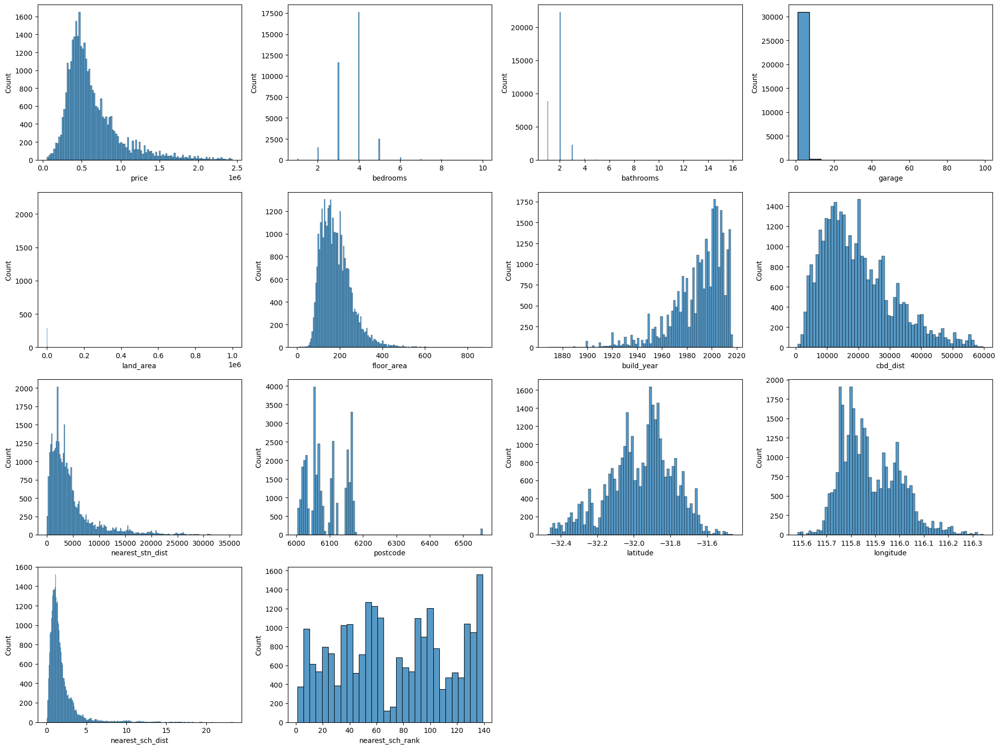

In [9]:
# Plotting histograms of all numerical columns
fig = plt.figure(figsize=(20, 15))
for i, col in enumerate(num_data.columns):
    plt.subplot(4, 4, i+1)
    sns.histplot(data=num_data, x=col)
fig.tight_layout()
fig.show()

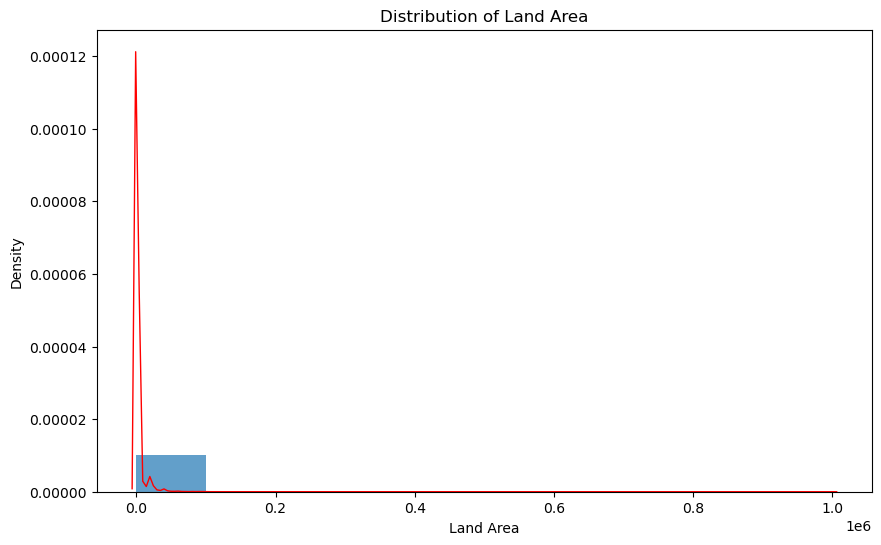

In [96]:
# land_area plot showing large skew
plt.figure(figsize=(10, 6))
plt.hist(df['land_area'], bins=10, density=True, alpha=0.7)
plt.xlabel('Land Area')
plt.ylabel('Density')
plt.title('Distribution of Land Area')

# Add a kernel density estimate (KDE) curve
sns.kdeplot(data=num_data['land_area'], color='red', linewidth=1)

plt.show()

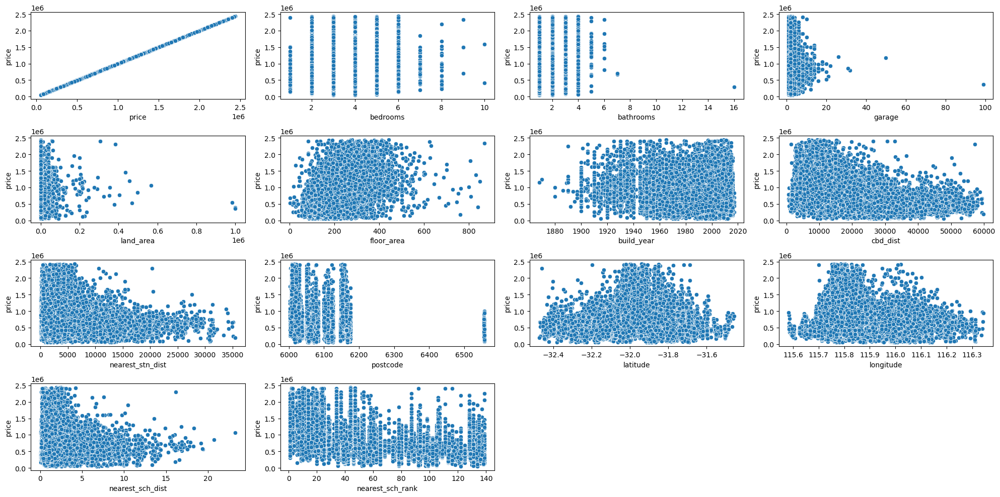

In [10]:
# Creating scatterplot of all numerical columns
fig = plt.figure(figsize=(20, 10))
for i, col in enumerate(num_cols):
    plt.subplot(4, 4, i+1)
    sns.scatterplot(data=num_data, x=col, y="price")
fig.tight_layout()
fig.show()

In [146]:
# Find outliers considering both price and land area within each SA2 area
def find_multivariate_outliers(df, sa2_column='sa2_name_2021', price_col='price', 
                             land_col='land_area', z_threshold=3):

    outliers = []
    
    for sa2_name in df[sa2_column].unique():
        sa2_data = df[df[sa2_column] == sa2_name]
        
        if len(sa2_data) > 1:
            
            # Calculate z-scores for price
            price_mean = sa2_data[price_col].mean()
            price_std = sa2_data[price_col].std()
            
            # Calculate z-scores for land area
            land_mean = sa2_data[land_col].mean()
            land_std = sa2_data[land_col].std()
            
            if price_std > 0 and land_std > 0:
                price_z_scores = (sa2_data[price_col] - price_mean) / price_std
                land_z_scores = (sa2_data[land_col] - land_mean) / land_std
                
                # Find outliers in either dimension
                outlier_mask = (abs(price_z_scores) > z_threshold) | (abs(land_z_scores) > z_threshold)
                
                if outlier_mask.any():
                    outlier_data = sa2_data[outlier_mask]
                    for idx, row in outlier_data.iterrows():
                        outliers.append({
                            'Original_Index': idx,
                            'SA2': sa2_name,
                            'Price': row[price_col],
                            'Land_Area': row[land_col],
                            'Price_Z_Score': price_z_scores[idx],
                            'Land_Z_Score': land_z_scores[idx],
                            'SA2_Mean_Price': price_mean,
                            'SA2_Mean_Land': land_mean,
                            'Price_Deviation': row[price_col] - price_mean,
                            'Land_Deviation': row[land_col] - land_mean,
                            'Address': row['address'],
                            'Suburb': row['suburb'],
                            'Bedrooms': row['bedrooms'],
                            'Bathrooms': row['bathrooms'],
                            'Floor_Area': row['floor_area']
                        })
    
    # Create DataFrame from outliers
    outliers_df = pd.DataFrame(outliers)
    
    if len(outliers_df) > 0:
        # Sort by maximum absolute z-score (either price or land)
        outliers_df['Max_Z_Score'] = outliers_df[['Price_Z_Score', 'Land_Z_Score']].abs().max(axis=1)
        outliers_df = outliers_df.sort_values('Max_Z_Score', ascending=False)
        
        # Format for display
        display_df = outliers_df.copy()
        display_df['Price'] = display_df['Price'].apply(lambda x: f"${x:,.2f}")
        display_df['SA2_Mean_Price'] = display_df['SA2_Mean_Price'].apply(lambda x: f"${x:,.2f}")
        display_df['Price_Deviation'] = display_df['Price_Deviation'].apply(lambda x: f"${x:,.2f}")
        
        print("\nOutliers by Price and Land Area:")
        print("-" * 100)
        print(display_df.to_string(float_format=lambda x: '{:.2f}'.format(x)))
        
        # Categorise outliers
        price_only = len(outliers_df[abs(outliers_df['Price_Z_Score']) > z_threshold][abs(outliers_df['Land_Z_Score']) <= z_threshold])
        land_only = len(outliers_df[abs(outliers_df['Land_Z_Score']) > z_threshold][abs(outliers_df['Price_Z_Score']) <= z_threshold])
        both = len(outliers_df[abs(outliers_df['Price_Z_Score']) > z_threshold][abs(outliers_df['Land_Z_Score']) > z_threshold])
        
        print(f"\nSummary:")
        print(f"Price outliers only: {price_only}")
        print(f"Land area outliers only: {land_only}")
        print(f"Both price and land outliers: {both}")
        print(f"Total outliers: {len(outliers_df)}")
        
    else:
        print("No outliers found with the current threshold.")
    
    return outliers_df

# Create DataFrames for different z-scores
z_2_5_df = find_multivariate_outliers(merged_df, z_threshold=2.5)
z_3_df = find_multivariate_outliers(merged_df, z_threshold=3)
z_3_5_df = find_multivariate_outliers(merged_df, z_threshold=3.5)


Outliers by Price and Land Area:
----------------------------------------------------------------------------------------------------
      Original_Index                                       SA2          Price  Land_Area  Price_Z_Score  Land_Z_Score SA2_Mean_Price  SA2_Mean_Land Price_Deviation  Land_Deviation                        Address              Suburb  Bedrooms  Bathrooms  Floor_Area  Max_Z_Score
1060           29287                       Iluka - Burns Beach    $400,000.00      17081          -1.27         25.34    $715,964.88         632.30    $-315,964.88        16448.70               7 Nashville Loop          Currambine         3          2         101        25.34
461            26779        Mindarie - Quinns Rocks - Jindalee    $322,000.00      40533          -0.78         24.72    $469,936.93         623.41    $-147,936.93        39909.59                 6 Emerson Turn            Clarkson         3          2         103        24.72
435             1438        Mindar

In [147]:
# Taking a look at dataframe with z-score 3.5 for both price and land area within same SA2 regions
z_3_5_df.head()

,Original_Index,SA2,Price,Land_Area,Price_Z_Score,Land_Z_Score,SA2_Mean_Price,SA2_Mean_Land,Price_Deviation,Land_Deviation,Address,Suburb,Bedrooms,Bathrooms,Floor_Area,Max_Z_Score
497,29287,Iluka - Burns Beach,400000,17081,-1,25,715965,632,-315965,16449,7 Nashville Loop,Currambine,3,2,101,25
247,26779,Mindarie - Quinns Rocks - Jindalee,322000,40533,-1,25,469937,623,-147937,39910,6 Emerson Turn,Clarkson,3,2,103,25
238,1438,Mindarie - Quinns Rocks - Jindalee,315000,40533,-1,25,469937,623,-154937,39910,10 Tambelyn Street,Clarkson,3,2,103,25
179,32713,Lockridge - Kiara,350000,17203,-1,22,448534,697,-98534,16506,9 May Road,Eden Hill,3,1,125,22
346,13826,Murdoch - Kardinya,2200000,18248,8,21,589507,713,1610493,17535,24/21 Ocean Drive,North Coogee,4,3,375,21


In [188]:
# Obtaining all outliers indices for dropping of rows
z35_outliers_index = z_3_5_df['Original_Index'].to_list()
merged_df.drop(z35_outliers_index, inplace=True)

In [189]:
# Setting limits for remaining outliers on bathrooms, garage and land_area and removal as the number of rows is minimal
outliers_df = merged_df[
    (merged_df["bathrooms"] >= 7)
    | (merged_df["garage"] >= 8)
    | (merged_df["land_area"] == 999999)
]

outliers_index = outliers_df.index.to_list()
merged_df.drop(outliers_index, inplace=True)

In [190]:
# Using value outside the normal ranking range to indicate property not serviced by an ATAR affiliated school eg. lack of secondary schools nearby
# 1 is best rank
bad_rank = 999

# Replace nulls with the bad rank
merged_df['nearest_sch_rank_filled'] = merged_df['nearest_sch_rank'].fillna(bad_rank)

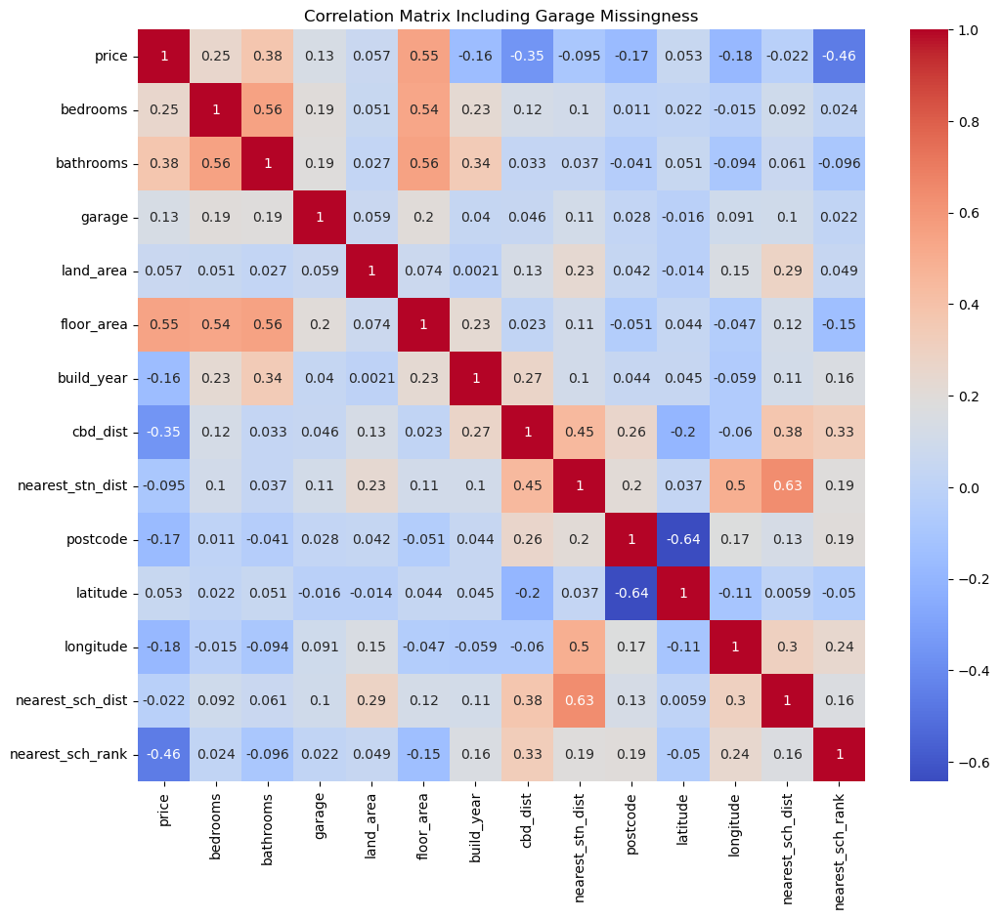

In [191]:
# Correlation matrix
plt.figure(figsize=(12, 10)) 
corr_matrix = num_data.corr()
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix Including Garage Missingness')
plt.show()

In [192]:
def impute_by_sa2_group(df, columns_to_impute=['garage', 'build_year']):
    """
    Impute missing values based on SA2 name group medians.
    Falls back to overall median if SA2 group has no non-null values.
    
    Parameters:
    df: DataFrame containing the data
    columns_to_impute: list of column names to impute
    
    Returns:
    DataFrame with imputed values
    """
    # Create a copy of the dataframe to avoid modifying the original
    df_imputed = df.copy()
    
    for column in columns_to_impute:
        # Calculate medians by SA2 group
        sa2_medians = df_imputed.groupby('sa2_name_2021')[column].median()
        
        # Calculate overall median for fallback
        overall_median = df_imputed[column].median()
        
        # Get indices of null values
        null_indices = df_imputed[column].isnull()
        
        # For each null value, try to impute with SA2 median first
        for idx in df_imputed[null_indices].index:
            sa2_name = df_imputed.loc[idx, 'sa2_name_2021']
            sa2_median = sa2_medians[sa2_name]
            
            # If SA2 median exists, use it; otherwise use overall median
            if pd.notnull(sa2_median):
                df_imputed.loc[idx, column] = sa2_median
            else:
                df_imputed.loc[idx, column] = overall_median
                
        # Round garage values to nearest integer if it's the garage column
        if column == 'garage':
            df_imputed[column] = df_imputed[column].round().astype(int)
        elif column == 'build_year':
            df_imputed[column] = df_imputed[column].round().astype(int)
            
        # Print imputation statistics
        print(f"\nImputation statistics for {column}:")
        print(f"Number of values imputed: {null_indices.sum()}")
        print("Sample of imputed values by SA2:")
        sample_imputed = df_imputed[null_indices].groupby('sa2_name_2021')[column].agg(['count', 'mean']).head()
        print(sample_imputed)
        
    return df_imputed

In [193]:
merged_df = impute_by_sa2_group(merged_df, columns_to_impute=['garage', 'build_year'])


Imputation statistics for garage:
Number of values imputed: 2411
Sample of imputed values by SA2:
                                count  mean
sa2_name_2021                              
Alkimos - Eglinton                 22     2
Balcatta - Hamersley                5     2
Baldivis - South                   11     2
Ballajura                          13     2
Bayswater - Embleton - Bedford     23     2

Imputation statistics for build_year:
Number of values imputed: 3054
Sample of imputed values by SA2:
                                count  mean
sa2_name_2021                              
Alkimos - Eglinton                 26  2014
Balcatta - Hamersley                2  1975
Baldivis - South                   20  2011
Ballajura                          15  1993
Bayswater - Embleton - Bedford     13  1970


In [194]:
# Log transformation for skew distributions and splitting out property date sold into year and month columns
merged_df['land_area_log'] = np.log(merged_df['land_area'])
merged_df['nearest_stn_dist_log'] = np.log1p(merged_df['nearest_stn_dist'])
merged_df['nearest_sch_dist_log'] = np.log1p(merged_df['nearest_sch_dist'])
merged_df['cbd_dist_log'] = np.log1p(merged_df['cbd_dist'])
merged_df['sale_year'] = merged_df['date_sold'].dt.year
merged_df['sale_month'] = merged_df['date_sold'].dt.month

In [195]:
# Final look at the merged_df information
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 32790 entries, 0 to 33655
Data columns (total 27 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   address                  32790 non-null  object        
 1   suburb                   32790 non-null  object        
 2   price                    32790 non-null  int64         
 3   bedrooms                 32790 non-null  int64         
 4   bathrooms                32790 non-null  int64         
 5   garage                   32790 non-null  int32         
 6   land_area                32790 non-null  int64         
 7   floor_area               32790 non-null  int64         
 8   build_year               32790 non-null  int32         
 9   cbd_dist                 32790 non-null  int64         
 10  nearest_stn              32790 non-null  object        
 11  nearest_stn_dist         32790 non-null  int64         
 12  date_sold                32790 non-nu

In [156]:
# Create interactive map visualisation of our property data, allowing easy viewing via large clusters and zooming in for more 
# granular view. Data displayed also shows property price and land area

icon_create_function = """
function(cluster) {
    var markers = cluster.getAllChildMarkers();
    var houseCount = markers.length;
    var totalPrice = 0;
    for (var i = 0; i < houseCount; i++) {
        var price = parseFloat(markers[i].options.title);
        totalPrice += price;
    }
    var avgPrice = totalPrice / houseCount;

    // Store the real average price for display
    var displayAvgPrice = avgPrice;

    // Define the price range for the gradient
    var minPrice = 400000;  
    var maxPrice = 800000; 

    // Compute ratio using clamped avgPrice, but do not change the actual avgPrice
    var colorAvgPrice = Math.max(minPrice, Math.min(avgPrice, maxPrice));
    var ratio = (colorAvgPrice - minPrice) / (maxPrice - minPrice);
    ratio = Math.pow(ratio, 1.5); // Amplify differences at higher end

    // Interpolate between two colors
    var startR = 255, startG = 245, startB = 245;
    var endR = 128, endG = 0, endB = 0;

    var r = Math.round(startR + ratio * (endR - startR));
    var g = Math.round(startG + ratio * (endG - startG));
    var b = Math.round(startB + ratio * (endB - startB));

    var color = 'rgba(' + r + ',' + g + ',' + b + ',0.8)';

    var html = `
        <div style="
            background: ${color}; 
            border-radius:50%; 
            padding:5px; 
            text-align:center;
            min-width:60px; 
            min-height:60px; 
            display:flex;
            flex-direction:column;
            justify-content:center;
            align-items:center;
        ">
            <div>Houses: ${houseCount}</div>
            <div>Avg: $${displayAvgPrice.toLocaleString('en-US', {
                minimumFractionDigits: 0,
                maximumFractionDigits: 0
            })}</div>
        </div>
    `;

    return new L.DivIcon({
        html: html,
        className: 'marker-cluster',
        iconSize: [60,60]
    });
}
"""

m = folium.Map(location=[merged_df['latitude'].mean(), merged_df['longitude'].mean()], zoom_start=6)
marker_cluster = MarkerCluster(icon_create_function=icon_create_function).add_to(m)

for _, row in merged_df.iterrows():
    popup_html = f"""
    Price: ${row['price']:,.0f}<br>
    Floor Area: {row['floor_area']:,.0f} sqm<br>
    Land Area: {row['land_area']:,.0f} sqm
    """
    folium.Marker(
        [row['latitude'], row['longitude']],
        popup=popup_html,
        title=str(row['price'])  # storing price for JS use
    ).add_to(marker_cluster)

m


In [196]:
# Selecting columns to be used for model training, validation and test dataset
selected_columns = ['price', 'bedrooms', 'bathrooms', 'floor_area', 'nearest_sch_rank_filled', 'garage', 'build_year', 
                    'land_area_log', 'nearest_stn_dist_log', 'cbd_dist_log', 'sale_year', 'sale_month', 'nearest_sch_dist_log', 'sa2_name_2021']
new_df = merged_df[selected_columns]

In [197]:
# One-hot encoding for newly created SA2 regions to replace suburb and postcode
sa2_encoded = pd.get_dummies(new_df['sa2_name_2021'], prefix='sa2')

# Add encoded columns back to original dataframe
new_df = pd.concat([new_df, sa2_encoded], axis=1)
new_df.drop('sa2_name_2021', axis=1, inplace=True)

In [198]:
# Save down csv file for easy loading if needed
new_df.to_csv('data/new_df.csv')

In [160]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, mean_absolute_error
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

np.random.seed(34)
torch.manual_seed(34)

def split_data(df, target_col='price', val_size=0.2, test_size=0.2, random_state=34):
    """
    Split data into train, validation, and test sets while preserving original indices
    Returns both full features and target splits for future use
    """
    # Store original index
    original_index = df.index
    
    # Separate features and target
    X = df.drop(target_col, axis=1)
    y = df[target_col]
    
    # First split: separate test set (maintain indices)
    X_temp, X_test, y_temp, y_test = train_test_split(
        X, y, 
        test_size=test_size, 
        random_state=random_state
    )
    
    # Second split: separate train and validation from temp (maintain indices)
    val_size_adjusted = val_size / (1 - test_size)
    X_train, X_val, y_train, y_val = train_test_split(
        X_temp, y_temp, 
        test_size=val_size_adjusted, 
        random_state=random_state
    )
    
    # Print split sizes and basic statistics
    print("Data Split Summary:")
    print("-----------------")
    print(f"Training set:   {len(X_train)} samples ({len(X_train)/len(df)*100:.1f}%)")
    print(f"Validation set: {len(X_val)} samples ({len(X_val)/len(df)*100:.1f}%)")
    print(f"Test set:       {len(X_test)} samples ({len(X_test)/len(df)*100:.1f}%)")
    
    print("\nPrice Statistics by Split:")
    print("------------------------")
    print(f"Training:   Mean=${y_train.mean():,.0f}, Min=${y_train.min():,.0f}, Max=${y_train.max():,.0f}")
    print(f"Validation: Mean=${y_val.mean():,.0f}, Min=${y_val.min():,.0f}, Max=${y_val.max():,.0f}")
    print(f"Test:       Mean=${y_test.mean():,.0f}, Min=${y_test.min():,.0f}, Max=${y_test.max():,.0f}")
    
    print("\nIndex Ranges:")
    print("------------")
    print(f"Training indices: {X_train.index.min()} to {X_train.index.max()}")
    print(f"Validation indices: {X_val.index.min()} to {X_val.index.max()}")
    print(f"Test indices: {X_test.index.min()} to {X_test.index.max()}")
    
    return X_train, X_val, X_test, y_train, y_val, y_test

In [161]:
def select_features(X_train, X_val, y_train, y_val, n_features=15):
    """
    Use Random Forest to select the most important features and analyse predictions
    using only training and validation data
    """
    # Initialize and fit Random Forest on training data only
    rf = RandomForestRegressor(n_estimators=100, random_state=34)
    rf.fit(X_train, y_train)
    
    # Get predictions for both training and validation sets
    train_predictions = rf.predict(X_train)
    val_predictions = rf.predict(X_val)
    
    # Calculate metrics for both sets
    from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
    
    # Training metrics
    train_mse = mean_squared_error(y_train, train_predictions)
    train_rmse = np.sqrt(train_mse)
    train_mae = mean_absolute_error(y_train, train_predictions)
    train_r2 = r2_score(y_train, train_predictions)
    
    # Validation metrics
    val_mse = mean_squared_error(y_val, val_predictions)
    val_rmse = np.sqrt(val_mse)
    val_mae = mean_absolute_error(y_val, val_predictions)
    val_r2 = r2_score(y_val, val_predictions)
    
    # Print metrics for both sets
    print("\nRandom Forest Performance Metrics:")
    print("---------------------------------")
    print("Training Set Metrics:")
    print(f"R² Score: {train_r2:.4f}")
    print(f"RMSE: ${train_rmse:,.2f}")
    print(f"MAE: ${train_mae:,.2f}")
    print("\nValidation Set Metrics:")
    print(f"R² Score: {val_r2:.4f}")
    print(f"RMSE: ${val_rmse:,.2f}")
    print(f"MAE: ${val_mae:,.2f}")
    
    # Print sample predictions for validation set
    print("\nSample Validation Set Predictions (First 10 houses):")
    print("----------------------------------------")
    comparison_df = pd.DataFrame({
        'Actual Price': y_val[:10],
        'Predicted Price': val_predictions[:10],
        'Difference': y_val[:10] - val_predictions[:10]
    })
    comparison_df['Difference %'] = (comparison_df['Difference'] / comparison_df['Actual Price']) * 100
    print(comparison_df.to_string(float_format=lambda x: '{:,.2f}'.format(x)))
    
    # Get feature importance scores
    feature_importance = pd.DataFrame({
        'feature': X_train.columns,
        'importance': rf.feature_importances_
    })
    
    # Sort by importance and format with more decimal places
    feature_importance = feature_importance.sort_values('importance', ascending=False)
    feature_importance['importance_pct'] = feature_importance['importance'] * 100
    
    print("\nTop Feature Importances:")
    print("------------------------")
    print(feature_importance.head(n_features).to_string(float_format=lambda x: '{:.4f}'.format(x)))
    
    # Select features
    selected_features = feature_importance.nlargest(n_features, 'importance')['feature'].tolist()
    X_train_selected = X_train[selected_features]
    X_val_selected = X_val[selected_features]
    
    return X_train_selected, X_val_selected, selected_features, feature_importance

In [162]:
def perform_cv_analysis(X, y, n_splits=5, random_state=34):
    """
    Perform k-fold cross-validation analysis
    """
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=random_state)
    
    # Lists to store metrics for each fold
    cv_rmse = []
    cv_mae = []
    cv_r2 = []
    cv_feature_importance = []
    
    print(f"\n{n_splits}-Fold Cross-Validation Results:")
    print("-" * 40)
    
    # Perform k-fold cross-validation
    for fold, (train_idx, val_idx) in enumerate(kf.split(X), 1):
        # Split data for this fold
        X_train_fold = X.iloc[train_idx]
        y_train_fold = y.iloc[train_idx]
        X_val_fold = X.iloc[val_idx]
        y_val_fold = y.iloc[val_idx]
        
        # Train model
        rf = RandomForestRegressor(n_estimators=100, random_state=random_state)
        rf.fit(X_train_fold, y_train_fold)
        
        # Make predictions
        val_pred = rf.predict(X_val_fold)
        
        # Calculate metrics
        rmse = np.sqrt(mean_squared_error(y_val_fold, val_pred))
        mae = mean_absolute_error(y_val_fold, val_pred)
        r2 = r2_score(y_val_fold, val_pred)
        
        # Store metrics
        cv_rmse.append(rmse)
        cv_mae.append(mae)
        cv_r2.append(r2)
        
        # Store feature importance
        cv_feature_importance.append(pd.Series(rf.feature_importances_, index=X.columns))
        
        print(f"\nFold {fold}:")
        print(f"RMSE: ${rmse:,.2f}")
        print(f"MAE: ${mae:,.2f}")
        print(f"R²: {r2:.4f}")
    
    # Calculate average feature importance across folds
    avg_importance = pd.DataFrame(cv_feature_importance).mean()
    importance_std = pd.DataFrame(cv_feature_importance).std()
    
    # Create feature importance summary
    feature_importance_summary = pd.DataFrame({
        'Mean_Importance': avg_importance,
        'Std_Importance': importance_std
    }).sort_values('Mean_Importance', ascending=False)
    
    # Print summary statistics
    print("\nCross-Validation Summary:")
    print("-" * 40)
    print(f"Average RMSE: ${np.mean(cv_rmse):,.2f} (±${np.std(cv_rmse):,.2f})")
    print(f"Average MAE: ${np.mean(cv_mae):,.2f} (±${np.std(cv_mae):,.2f})")
    print(f"Average R²: {np.mean(cv_r2):.4f} (±{np.std(cv_r2):.4f})")
    
    print("\nTop 10 Features (by average importance):")
    print(feature_importance_summary.head(10).to_string(float_format=lambda x: '{:.4f}'.format(x)))
    
    return {
        'metrics': {
            'rmse': cv_rmse,
            'mae': cv_mae,
            'r2': cv_r2
        },
        'feature_importance': feature_importance_summary
    }

In [170]:
def plot_cv_results(cv_results):
    """
    Visualise cross-validation results
    """
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))
    
    # Plot feature importance with error bars
    importance_df = cv_results['feature_importance'].head(10)
    axes[0,0].barh(importance_df.index, 
                   importance_df['Mean_Importance'],
                   xerr=importance_df['Std_Importance'],
                   alpha=0.8)
    axes[0,0].set_title('Top 10 Feature Importance (with std dev)')
    axes[0,0].set_xlabel('Importance')
    
    # Plot RMSE distribution
    axes[0,1].boxplot(cv_results['metrics']['rmse'])
    axes[0,1].set_title('RMSE Distribution Across Folds')
    axes[0,1].set_ylabel('RMSE ($)')
    
    # Plot R² distribution
    axes[1,0].boxplot(cv_results['metrics']['r2'])
    axes[1,0].set_title('R² Distribution Across Folds')
    axes[1,0].set_ylabel('R²')
    
    # Plot MAE distribution
    axes[1,1].boxplot(cv_results['metrics']['mae'])
    axes[1,1].set_title('MAE Distribution Across Folds')
    axes[1,1].set_ylabel('MAE ($)')
    
    plt.tight_layout()
    plt.show()

In [199]:
X_train, X_val, X_test, y_train, y_val, y_test = split_data(new_df)

Data Split Summary:
-----------------
Training set:   19674 samples (60.0%)
Validation set: 6558 samples (20.0%)
Test set:       6558 samples (20.0%)

Price Statistics by Split:
------------------------
Training:   Mean=$629,664, Min=$51,000, Max=$2,440,000
Validation: Mean=$625,043, Min=$63,000, Max=$2,425,000
Test:       Mean=$634,669, Min=$54,500, Max=$2,425,000

Index Ranges:
------------
Training indices: 0 to 33655
Validation indices: 14 to 33652
Test indices: 23 to 33653


In [200]:
cv_results = perform_cv_analysis(X_train, y_train, n_splits=5)


5-Fold Cross-Validation Results:
----------------------------------------

Fold 1:
RMSE: $144,259.13
MAE: $89,142.30
R²: 0.8284

Fold 2:
RMSE: $146,289.80
MAE: $91,336.65
R²: 0.8216

Fold 3:
RMSE: $140,702.83
MAE: $87,488.01
R²: 0.8307

Fold 4:
RMSE: $144,814.76
MAE: $90,532.50
R²: 0.8195

Fold 5:
RMSE: $142,374.97
MAE: $89,053.42
R²: 0.8417

Cross-Validation Summary:
----------------------------------------
Average RMSE: $143,688.30 (±$1,949.38)
Average MAE: $89,510.57 (±$1,327.72)
Average R²: 0.8284 (±0.0079)

Top 10 Features (by average importance):
                                         Mean_Importance  Std_Importance
nearest_sch_rank_filled                           0.3289          0.0039
floor_area                                        0.2603          0.0021
cbd_dist_log                                      0.1080          0.0022
land_area_log                                     0.0508          0.0007
sale_year                                         0.0396          0.0006
bu

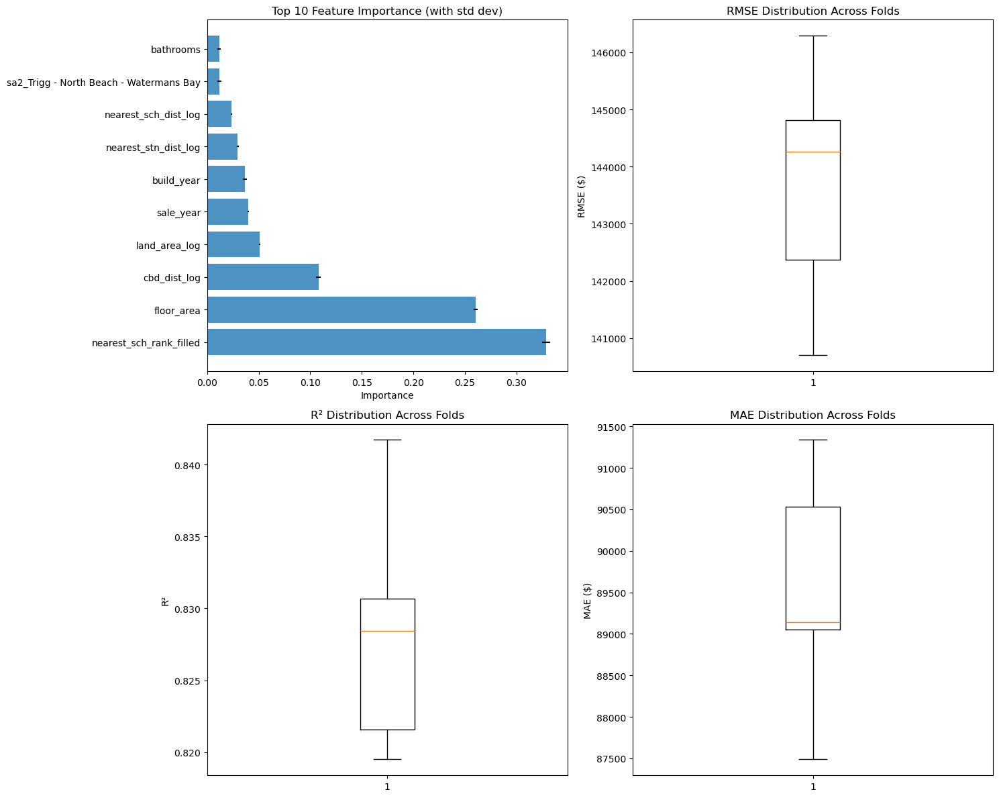

In [201]:
plot_cv_results(cv_results)

In [202]:
# Store top 10 features recommended by Random Forest model to be used later on in neural network model
selected_features = cv_results['feature_importance'].head(10).index.tolist()

In [203]:
class HousePriceDataset(Dataset):
    def __init__(self, X, y, scaler_X=None, scaler_y=None):
        """
        Initialize dataset with separate scalers for features and target
        """
        # Store original indices
        self.indices = X.index.values
        
        # Scale features
        if scaler_X is None:
            self.scaler_X = StandardScaler()
            self.X = torch.FloatTensor(self.scaler_X.fit_transform(X))
        else:
            self.scaler_X = scaler_X
            self.X = torch.FloatTensor(self.scaler_X.transform(X))
        
        # Scale target (prices)
        if scaler_y is None:
            self.scaler_y = StandardScaler()
            self.y = torch.FloatTensor(self.scaler_y.fit_transform(y.values.reshape(-1, 1)))
        else:
            self.scaler_y = scaler_y
            self.y = torch.FloatTensor(self.scaler_y.transform(y.values.reshape(-1, 1)))
    
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        return self.X[idx], self.y[idx], self.indices[idx]

In [204]:
# Network Architectures
class BaseNet(nn.Module):
    def __init__(self, input_size): 
        super(BaseNet, self).__init__() 
        self.layers = nn.Sequential(
            nn.Linear(input_size, 64),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 1)
        )
    
    def forward(self, x):
        return self.layers(x)

class DeepNet(nn.Module):
    def __init__(self, input_size):
        super(DeepNet, self).__init__() 
        self.layers = nn.Sequential(
            nn.Linear(input_size, 256),
            nn.ReLU(),
            nn.BatchNorm1d(256),
            nn.Dropout(0.2),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.BatchNorm1d(128),
            nn.Dropout(0.2),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.BatchNorm1d(64),
            nn.Linear(64, 1)
        )
    
    def forward(self, x):
        return self.layers(x)

class ResidualNet(nn.Module):
    def __init__(self, input_size):  
        super(ResidualNet, self).__init__() 
        self.fc1 = nn.Linear(input_size, 128)
        self.fc2 = nn.Linear(128, 128)
        self.fc3 = nn.Linear(128, 1)
        self.bn1 = nn.BatchNorm1d(128)
        self.bn2 = nn.BatchNorm1d(128)
        self.dropout = nn.Dropout(0.2)
    
    def forward(self, x):
        identity = self.fc1(x)
        out = self.bn1(identity)
        out = nn.ReLU()(out)
        out = self.dropout(out)
        out = self.fc2(out)
        out = self.bn2(out)
        out = nn.ReLU()(out + identity)
        out = self.fc3(out)
        return out

class WideNet(nn.Module):
    def __init__(self, input_size):
        super(WideNet, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(input_size, 512),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(512, 512),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(512, 1)
        )
    
    def forward(self, x):
        return self.layers(x)

class PyramidNet(nn.Module):
    def __init__(self, input_size):
        super(PyramidNet, self).__init__()
        self.layers = nn.Sequential(
            nn.Linear(input_size, 256),
            nn.LeakyReLU(0.1),
            nn.BatchNorm1d(256),
            nn.Linear(256, 128),
            nn.LeakyReLU(0.1),
            nn.BatchNorm1d(128),
            nn.Linear(128, 64),
            nn.LeakyReLU(0.1),
            nn.BatchNorm1d(64),
            nn.Linear(64, 32),
            nn.LeakyReLU(0.1),
            nn.Linear(32, 1)
        )
    
    def forward(self, x):
        return self.layers(x)

class DenseNet(nn.Module):
    def __init__(self, input_size):
        super(DenseNet, self).__init__()
        self.fc1 = nn.Linear(input_size, 128)
        self.fc2 = nn.Linear(128 + input_size, 64)
        self.fc3 = nn.Linear(64 + 128 + input_size, 32)
        self.fc4 = nn.Linear(32 + 64 + 128 + input_size, 1)
        self.bn1 = nn.BatchNorm1d(128)
        self.bn2 = nn.BatchNorm1d(64)
        self.bn3 = nn.BatchNorm1d(32)
        self.dropout = nn.Dropout(0.2)
        
    def forward(self, x):
        x1 = self.dropout(nn.ReLU()(self.bn1(self.fc1(x))))
        x2 = torch.cat([x, x1], dim=1)
        x2 = self.dropout(nn.ReLU()(self.bn2(self.fc2(x2))))
        x3 = torch.cat([x, x1, x2], dim=1)
        x3 = self.dropout(nn.ReLU()(self.bn3(self.fc3(x3))))
        x4 = torch.cat([x, x1, x2, x3], dim=1)
        return self.fc4(x4)

# Extended model registry
MODEL_REGISTRY = {
    'base': BaseNet,
    'deep': DeepNet,
    'residual': ResidualNet,
    'wide': WideNet,
    'pyramid': PyramidNet,
    'dense': DenseNet
}

In [205]:
# Early stopping if no improvement is shown during training loop
class EarlyStopping:
    def __init__(self, patience=7, min_delta=0, verbose=False):
        self.patience = patience
        self.min_delta = min_delta
        self.verbose = verbose
        self.counter = 0
        self.best_loss = None
        self.early_stop = False
        self.best_model = None

    def __call__(self, val_loss, model):
        if self.best_loss is None:
            self.best_loss = val_loss
            self.best_model = model.state_dict()
        elif val_loss > self.best_loss - self.min_delta:
            self.counter += 1
            if self.verbose:
                print(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_loss = val_loss
            self.best_model = model.state_dict()
            self.counter = 0

In [206]:
def train_model(model, train_loader, val_loader, scaler_y, epochs=500, lr=0.001, patience=7, 
                optimizer_name='adam', scheduler_name='plateau', device=None):
    """
    Training function with CUDA support
    """
    # Set device
    if device is None:
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    # Move model to device
    model = model.to(device)
    print(f"Using device: {device}")
    
    criterion = nn.MSELoss()
    
    # Optimizer selection
    if optimizer_name.lower() == 'adam':
        optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    elif optimizer_name.lower() == 'adamw':
        optimizer = torch.optim.AdamW(model.parameters(), lr=lr, weight_decay=0.01)
    elif optimizer_name.lower() == 'rmsprop':
        optimizer = torch.optim.RMSprop(model.parameters(), lr=lr)
    else:
        raise ValueError(f"Unsupported optimizer: {optimizer_name}")
    
    # Scheduler selection
    if scheduler_name.lower() == 'plateau':
        scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
            optimizer, mode='min', patience=patience//2, factor=0.5, verbose=True
        )
    elif scheduler_name.lower() == 'cosine':
        scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(
            optimizer, T_max=epochs, eta_min=1e-6
        )
    elif scheduler_name is None:
        scheduler = None
    
    early_stopping = EarlyStopping(patience=patience, verbose=True)
    
    train_losses = []
    val_losses = []
    learning_rates = []
    
    for epoch in range(epochs):
        # Training
        model.train()
        train_loss = 0
        for X_batch, y_batch, _ in train_loader:
            # Move batch to device
            X_batch = X_batch.to(device)
            y_batch = y_batch.to(device)
            
            optimizer.zero_grad()
            y_pred = model(X_batch)
            loss = criterion(y_pred, y_batch)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()
        
        # Validation
        model.eval()
        val_loss = 0
        with torch.no_grad():
            for X_batch, y_batch, _ in val_loader:
                # Move batch to device
                X_batch = X_batch.to(device)
                y_batch = y_batch.to(device)
                
                y_pred = model(X_batch)
                loss = criterion(y_pred, y_batch)
                val_loss += loss.item()
        
        train_loss = train_loss / len(train_loader)
        val_loss = val_loss / len(val_loader)
        train_losses.append(train_loss)
        val_losses.append(val_loss)
        learning_rates.append(optimizer.param_groups[0]['lr'])
        
        if (epoch + 1) % 10 == 0:
            print(f'Epoch [{epoch+1}/{epochs}]')
            print(f'Train Loss: {train_loss:.4f}')
            print(f'Val Loss: {val_loss:.4f}')
            print(f'Learning Rate: {optimizer.param_groups[0]["lr"]:.6f}')
            print('-' * 50)
        
        # Step the scheduler
        if scheduler is not None:
            if isinstance(scheduler, torch.optim.lr_scheduler.ReduceLROnPlateau):
                scheduler.step(val_loss)
            else:
                scheduler.step()
        
        early_stopping(val_loss, model)
        if early_stopping.early_stop:
            print(f"Early stopping triggered at epoch {epoch+1}")
            break
    
    # Load the best model state
    model.load_state_dict(early_stopping.best_model)
    
    # Get predictions from the best model
    model.eval()
    best_predictions = []
    best_actuals = []
    best_indices = []
    
    with torch.no_grad():
        for X_batch, y_batch, idx_batch in val_loader:
            # Move batch to device
            X_batch = X_batch.to(device)
            y_batch = y_batch.to(device)
            
            y_pred = model(X_batch)
            # Move predictions back to CPU for numpy operations
            y_pred = y_pred.cpu()
            y_batch = y_batch.cpu()
            
            y_pred_unscaled = scaler_y.inverse_transform(y_pred.numpy())
            y_batch_unscaled = scaler_y.inverse_transform(y_batch.numpy())
            
            best_predictions.extend(y_pred_unscaled.flatten())
            best_actuals.extend(y_batch_unscaled.flatten())
            best_indices.extend(idx_batch.numpy())
    
    return {
        'train_losses': train_losses,
        'val_losses': val_losses,
        'learning_rates': learning_rates,
        'best_val_predictions': best_predictions,
        'best_val_actuals': best_actuals,
        'best_val_indices': best_indices
    }

In [207]:
# Test set evaluation
def evaluate_test_set(model, test_loader, scaler_y, X_test, device=None):
    """
    Evaluate model on test set with CUDA support
    """
    # Set device if not provided
    if device is None:
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    # Ensure model is on the correct device
    model = model.to(device)
    model.eval()
    
    test_predictions = []
    test_actuals = []
    indices = []
    
    with torch.no_grad():
        for batch_X, batch_y, batch_indices in test_loader:
            # Move batch data to device
            batch_X = batch_X.to(device)
            batch_y = batch_y.to(device)
            
            # Get predictions
            outputs = model(batch_X)
            outputs = outputs.cpu()
            batch_y = batch_y.cpu()
            
            # Store predictions and actuals
            test_predictions.extend(outputs.numpy())
            test_actuals.extend(batch_y.numpy())
            indices.extend(batch_indices.numpy())
    
    # Convert to numpy arrays
    test_predictions = np.array(test_predictions)
    test_actuals = np.array(test_actuals)
    
    # Inverse transform predictions and actuals
    if scaler_y:
        test_predictions = scaler_y.inverse_transform(test_predictions.reshape(-1, 1)).flatten()
        test_actuals = scaler_y.inverse_transform(test_actuals.reshape(-1, 1)).flatten()
    
    # Calculate metrics
    test_rmse = np.sqrt(mean_squared_error(test_actuals, test_predictions))
    test_r2 = r2_score(test_actuals, test_predictions)
    test_mae = mean_absolute_error(test_actuals, test_predictions)
    
    # Calculate absolute errors for finding worst predictions
    errors = np.abs(test_predictions - test_actuals)
    worst_indices = np.argsort(errors)[-5:][::-1]  # Get indices of 5 worst predictions
    
    # Optional: Print CUDA memory usage after evaluation
    if device.type == 'cuda':
        print(f"GPU Memory after evaluation: {torch.cuda.memory_allocated(device) / 1024**2:.2f} MB")
    
    return {
        'metrics': {
            'rmse': test_rmse,
            'r2': test_r2,
            'mae': test_mae
        },
        'predictions': test_predictions,
        'actuals': test_actuals,
        'worst_predictions': {
            'indices': [indices[i] for i in worst_indices],
            'predictions': test_predictions[worst_indices],
            'actuals': test_actuals[worst_indices],
            'errors': errors[worst_indices]
        }
    }

In [208]:
def train_and_evaluate_model(
    model_name,
    X_train, X_val, X_test,
    y_train, y_val, y_test,
    selected_features=None,
    epochs=100,
    batch_size=32,
    lr=0.001,
    patience=7,
    verbose=True,
    optimizer_name='adam',
    scheduler_name='plateau',
    device=None
):
    """
    Complete training and evaluation function with CUDA support
    
    Args:
        model_name (str): Name of the model from MODEL_REGISTRY
        X_train, X_val, X_test (pd.DataFrame): Feature data for each set
        y_train, y_val, y_test (pd.Series): Target data for each set
        selected_features (list): Optional list of features to use
        epochs (int): Number of training epochs
        batch_size (int): Batch size for training
        lr (float): Learning rate
        patience (int): Patience for early stopping
        verbose (bool): Whether to print progress
        optimizer_name (str): Name of optimizer to use
        scheduler_name (str): Name of learning rate scheduler to use
        device (torch.device): Device to use for training
    """
    # Set device if not provided
    if device is None:
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    if verbose:
        print(f"\nUsing device: {device}")
        if device.type == 'cuda':
            print(f"GPU: {torch.cuda.get_device_name(0)}")
    
    # Use selected features if provided
    if selected_features is not None:
        X_train_model = X_train[selected_features]
        X_val_model = X_val[selected_features]
        X_test_model = X_test[selected_features]
        input_size = len(selected_features)
        if verbose:
            print(f"\nUsing {input_size} selected features")
    else:
        X_train_model = X_train
        X_val_model = X_val
        X_test_model = X_test
        input_size = X_train.shape[1]
        if verbose:
            print(f"\nUsing all {input_size} features")

    # Print index ranges for verification
    if verbose:
        print("\nIndex Ranges:")
        print(f"Train: {X_train_model.index.min()} to {X_train_model.index.max()}")
        print(f"Val: {X_val_model.index.min()} to {X_val_model.index.max()}")
        print(f"Test: {X_test_model.index.min()} to {X_test_model.index.max()}")

    # Prepare datasets
    train_dataset = HousePriceDataset(X_train_model, y_train)
    val_dataset = HousePriceDataset(
        X_val_model, 
        y_val, 
        train_dataset.scaler_X,
        train_dataset.scaler_y
    )
    test_dataset = HousePriceDataset(
        X_test_model, 
        y_test,
        train_dataset.scaler_X,
        train_dataset.scaler_y
    )

    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

    # Model initialisation
    model_class = MODEL_REGISTRY[model_name]
    model = model_class(input_size=input_size)
    model = model.to(device)

    if verbose:
        print(f"\nTraining {model_name} model")
        print(f"Input size: {input_size}")
        print(f"Optimizer: {optimizer_name}")
        print(f"Scheduler: {scheduler_name}")

    try:
        # Train model
        training_results = train_model(
            model, 
            train_loader, 
            val_loader,
            train_dataset.scaler_y,
            epochs=epochs,
            lr=lr,
            patience=patience,
            optimizer_name=optimizer_name,
            scheduler_name=scheduler_name,
            device=device
        )

        # Calculate validation metrics
        final_val_rmse = np.sqrt(mean_squared_error(
            training_results['best_val_actuals'], 
            training_results['best_val_predictions']
        ))
        final_val_r2 = r2_score(
            training_results['best_val_actuals'], 
            training_results['best_val_predictions']
        )
        final_val_mae = mean_absolute_error(
            training_results['best_val_actuals'],
            training_results['best_val_predictions']
        )

        # Evaluate on test set
        test_results = evaluate_test_set(
            model, 
            test_loader, 
            train_dataset.scaler_y, 
            X_test_model,
            device=device
        )

        if verbose:
            print(f"\nBest Model Validation Metrics for {model_name}:")
            print(f"RMSE: ${final_val_rmse:,.2f}")
            print(f"MAE: ${final_val_mae:,.2f}")
            print(f"R²: {final_val_r2:.4f}")
            print("\nTest Set Metrics:")
            print("-" * 50)
            print(f"Test RMSE: ${test_results['metrics']['rmse']:,.2f}")
            print(f"Test MAE: ${test_results['metrics']['mae']:,.2f}")
            print(f"Test R²: {test_results['metrics']['r2']:.6f}")
            
            # Print worst test predictions
            print("\nWorst Test Set Predictions:")
            print("-" * 50)
            worst = test_results['worst_predictions']
            
            results_df = pd.DataFrame({
                'Original Index': worst['indices'],
                'Actual Price': worst['actuals'],
                'Predicted Price': worst['predictions'],
                'Absolute Error': worst['errors'],
                'Percentage Error': (worst['errors'] / worst['actuals']) * 100
            })
            
            # Add original data columns for verification
            for col in ['bedrooms', 'bathrooms', 'floor_area', 'land_area']:
                if col in X_test.columns:
                    results_df[col] = X_test.loc[worst['indices'], col].values
            
            print(results_df.to_string(float_format=lambda x: '{:,.2f}'.format(x)))
            
            # Print GPU memory usage if applicable
            if device.type == 'cuda':
                print(f"\nGPU Memory Used: {torch.cuda.memory_allocated() / 1024**2:.2f} MB")

    except RuntimeError as e:
        if "out of memory" in str(e) and device.type == 'cuda':
            torch.cuda.empty_cache()
            print("GPU out of memory, try reducing batch size or model size")
        raise e

    finally:
        # Clean up GPU memory
        if device.type == 'cuda':
            torch.cuda.empty_cache()

    return {
        'model': model,
        'training_results': training_results,
        'test_results': test_results,
        'metrics': {
            'val': {
                'rmse': final_val_rmse,
                'mae': final_val_mae,
                'r2': final_val_r2
            },
            'test': test_results['metrics']
        },
        'scalers': {
            'X': train_dataset.scaler_X,
            'y': train_dataset.scaler_y
        }
    }

In [209]:
def save_model_metrics(results_dict, save_path='model_metrics.csv'):
    metrics_data = []
    
    # Multiple models
    for model_name, result in results_dict.items():
        # Parse model configuration from name
        name_parts = model_name.split('_')
        model_type = name_parts[0]
        optimizer = name_parts[1] if len(name_parts) > 1 else 'N/A'
        scheduler = name_parts[2] if len(name_parts) > 2 else 'N/A'
        
        # Extract training results
        training_results = result['training_results']
        early_stop_epoch = training_results.get('early_stop_epoch', 
                                              len(training_results['train_losses']))
        best_epoch = training_results.get('best_epoch', early_stop_epoch)
        
        metrics = {
            'model_name': model_name,
            'model_type': model_type,
            # Metrics
            'val_rmse': result['metrics']['val']['rmse'],
            'val_r2': result['metrics']['val']['r2'],
            'val_mae': result['metrics']['val']['mae'],
            'test_rmse': result['metrics']['test']['rmse'],
            'test_r2': result['metrics']['test']['r2'],
            'test_mae': result['metrics']['test']['mae'],
            # Configuration
            'optimizer': optimizer,
            'scheduler': scheduler,
            'n_features': result['model'].layers[0].in_features if hasattr(result['model'], 'layers') 
                         else result['model'].fc1.in_features,
            # Training details
            'epochs': len(training_results['train_losses']),
            'early_stop_epoch': early_stop_epoch,
            'best_epoch': best_epoch,
            'min_val_loss': min(training_results['val_losses']),
            'timestamp': pd.Timestamp.now()
        }
        metrics_data.append(metrics)
    
    # Create DataFrame and sort by test R2 (descending)
    metrics_df = pd.DataFrame(metrics_data)
    metrics_df = metrics_df.sort_values('test_r2', ascending=False)
    
    # Save complete metrics
    metrics_df.to_csv(save_path, index=False)
    
    # Create display DataFrame with only requested columns
    display_df = metrics_df[['model_name', 'test_rmse', 'test_r2', 'test_mae']].copy()
    
    # Format the display columns
    display_df['test_rmse'] = display_df['test_rmse'].apply(lambda x: f"${x:,.2f}")
    display_df['test_mae'] = display_df['test_mae'].apply(lambda x: f"${x:,.2f}")
    display_df['test_r2'] = display_df['test_r2'].apply(lambda x: f"{x:.6f}")
    
    # Display formatted results
    print("\nModel Performance (Sorted by Test R²):")
    print("-" * 80)
    print(display_df.to_string(index=False))
    
    return metrics_df

In [210]:
# Train models using top 10 features selected by our Random Forest model earlier on
model_names = ['base', 'deep', 'residual', 'wide', 'pyramid', 'dense']
optimizer_configs = ['adam', 'adamw']  # Can add on more optimizer types
scheduler_configs = ['plateau', 'cosine']  # Can add on more scheduler types

# Initialise the results dictionary
results_selected = {}

# Iterate over each model and train/evaluate
for model in model_names:
    for opt in optimizer_configs:
        for sched in scheduler_configs:
            model_key = f"{model}_{opt}_{sched}"
            results_selected[model_key] = train_and_evaluate_model(
                model,
                X_train, X_val, X_test,
                y_train, y_val, y_test,
                selected_features=selected_features,
                epochs=100,
                lr=0.001,
                patience=7,
                optimizer_name=opt,
                scheduler_name=sched
            )


Using device: cuda
GPU: NVIDIA GeForce RTX 3090 Ti

Using 10 selected features

Index Ranges:
Train: 0 to 33655
Val: 14 to 33652
Test: 23 to 33653

Training base model
Input size: 10
Optimizer: adam
Scheduler: plateau
Using device: cuda
EarlyStopping counter: 1 out of 7
EarlyStopping counter: 2 out of 7
Epoch [10/100]
Train Loss: 0.2923
Val Loss: 0.2769
Learning Rate: 0.001000
--------------------------------------------------
EarlyStopping counter: 1 out of 7
EarlyStopping counter: 1 out of 7
EarlyStopping counter: 1 out of 7
Epoch [20/100]
Train Loss: 0.2619
Val Loss: 0.2495
Learning Rate: 0.001000
--------------------------------------------------
EarlyStopping counter: 1 out of 7
EarlyStopping counter: 2 out of 7
EarlyStopping counter: 3 out of 7
EarlyStopping counter: 1 out of 7
EarlyStopping counter: 2 out of 7
EarlyStopping counter: 3 out of 7
Epoch [30/100]
Train Loss: 0.2493
Val Loss: 0.2382
Learning Rate: 0.001000
--------------------------------------------------
EarlyStopp

In [211]:
# Save and display metrics
results_selected_metrics_df = save_model_metrics(results_selected, 'results/selected_features_model_metrics.csv')


Model Performance (Sorted by Test R²):
--------------------------------------------------------------------------------
            model_name   test_rmse  test_r2    test_mae
     deep_adam_plateau $157,044.25 0.799680 $100,390.27
   pyramid_adam_cosine $159,678.22 0.792904 $101,649.70
 pyramid_adamw_plateau $159,743.84 0.792733 $100,781.60
  pyramid_adam_plateau $160,970.83 0.789537 $101,925.57
     wide_adamw_cosine $161,504.89 0.788138 $102,395.38
     deep_adamw_cosine $161,529.27 0.788074 $103,095.77
  pyramid_adamw_cosine $161,693.88 0.787642 $103,536.81
 residual_adamw_cosine $161,769.53 0.787443 $104,096.36
     wide_adam_plateau $161,829.41 0.787286 $103,354.99
residual_adamw_plateau $161,950.95 0.786966 $104,551.22
    wide_adamw_plateau $162,008.78 0.786814 $102,310.98
      wide_adam_cosine $162,852.34 0.784588 $103,443.38
  residual_adam_cosine $163,773.56 0.782144 $105,580.84
   dense_adamw_plateau $164,859.72 0.779245 $105,902.84
      deep_adam_cosine $164,956.03 0.77

In [212]:
# Train models using all features
model_names = ['base', 'deep', 'residual', 'wide', 'pyramid', 'dense']
optimizer_configs = ['adam', 'adamw']  # Can add on more optimizer types
scheduler_configs = ['plateau', 'cosine']  # Can add on more scheduler types

# Initialise the results dictionary
results_all = {}

# Iterate over each model and train/evaluate
for model in model_names:
    for opt in optimizer_configs:
        for sched in scheduler_configs:
            model_key = f"{model}_{opt}_{sched}"
            results_all[model_key] = train_and_evaluate_model(
                model,
                X_train, X_val, X_test,
                y_train, y_val, y_test,
                epochs=100,
                lr=0.001,
                patience=7,
                optimizer_name=opt,
                scheduler_name=sched
            )


Using device: cuda
GPU: NVIDIA GeForce RTX 3090 Ti

Using all 95 features

Index Ranges:
Train: 0 to 33655
Val: 14 to 33652
Test: 23 to 33653

Training base model
Input size: 95
Optimizer: adam
Scheduler: plateau
Using device: cuda
EarlyStopping counter: 1 out of 7
Epoch [10/100]
Train Loss: 0.1755
Val Loss: 0.1804
Learning Rate: 0.001000
--------------------------------------------------
EarlyStopping counter: 1 out of 7
EarlyStopping counter: 2 out of 7
EarlyStopping counter: 1 out of 7
EarlyStopping counter: 2 out of 7
EarlyStopping counter: 3 out of 7
EarlyStopping counter: 4 out of 7
EarlyStopping counter: 1 out of 7
Epoch [20/100]
Train Loss: 0.1513
Val Loss: 0.1703
Learning Rate: 0.000500
--------------------------------------------------
EarlyStopping counter: 1 out of 7
EarlyStopping counter: 1 out of 7
EarlyStopping counter: 2 out of 7
EarlyStopping counter: 3 out of 7
EarlyStopping counter: 4 out of 7
EarlyStopping counter: 5 out of 7
Epoch [30/100]
Train Loss: 0.1382
Val L

In [213]:
# Save and display metrics
results_all_metrics_df = save_model_metrics(results_all, 'results/all_features_model_metrics.csv')


Model Performance (Sorted by Test R²):
--------------------------------------------------------------------------------
            model_name   test_rmse  test_r2   test_mae
   dense_adamw_plateau $136,158.59 0.849419 $85,274.26
    dense_adam_plateau $136,455.75 0.848761 $85,064.29
 residual_adam_plateau $136,674.86 0.848275 $86,018.03
residual_adamw_plateau $137,820.67 0.845720 $86,711.34
  residual_adam_cosine $138,365.36 0.844498 $88,478.70
 pyramid_adamw_plateau $138,691.45 0.843764 $86,608.05
  pyramid_adam_plateau $138,913.88 0.843263 $86,665.94
 residual_adamw_cosine $139,370.88 0.842230 $88,842.00
    deep_adamw_plateau $139,836.58 0.841174 $88,709.95
     deep_adamw_cosine $139,844.55 0.841156 $86,717.10
     wide_adam_plateau $139,902.66 0.841023 $86,065.15
    wide_adamw_plateau $140,395.52 0.839901 $85,676.13
     deep_adam_plateau $140,937.98 0.838662 $87,434.70
      wide_adam_cosine $141,661.53 0.837001 $88,212.55
      deep_adam_cosine $142,206.50 0.835745 $92,723.38

In [220]:
# Examining details of worst test set predictions
print(merged_df.loc[20914].to_string())  

address                                        4 Hepworth Road
suburb                                                   Trigg
price                                                  1790000
bedrooms                                                     4
bathrooms                                                    2
garage                                                       2
land_area                                                  462
floor_area                                                 130
build_year                                                2009
cbd_dist                                                 13000
nearest_stn                                   Stirling Station
nearest_stn_dist                                          5200
date_sold                                  2016-12-01 00:00:00
postcode                                                  6029
latitude                                                   -32
longitude                                              

In [218]:
# Checking SA2 region of worst test set predictions
merged_df[merged_df['sa2_name_2021'] == 'Trigg - North Beach - Watermans Bay'].describe()

,price,bedrooms,bathrooms,garage,land_area,floor_area,build_year,cbd_dist,nearest_stn_dist,date_sold,...,longitude,nearest_sch_dist,nearest_sch_rank,nearest_sch_rank_filled,land_area_log,nearest_stn_dist_log,nearest_sch_dist_log,cbd_dist_log,sale_year,sale_month
count,709,709,709,709,709,709,709,709,709,709,...,709,709,708,709,709,709,709,709,709,709
mean,1049743,4,2,2,754,211,1985,14615,3566,2016-08-15 15:38:20.141043712,...,116,1,29,31,7,8,1,10,2016,7
min,340000,1,1,1,103,1,1933,11800,214,2009-03-01 00:00:00,...,116,0,7,7,5,5,0,9,2009,1
25%,795000,3,2,2,507,154,1976,13300,3000,2015-01-01 00:00:00,...,116,1,7,7,6,8,1,9,2015,4
50%,920000,4,2,2,709,199,1983,14700,3800,2017-01-01 00:00:00,...,116,1,32,32,7,8,1,10,2017,7
75%,1255000,4,2,2,784,254,1996,15600,4200,2018-07-01 00:00:00,...,116,2,47,47,7,8,1,10,2018,10
max,2390000,6,6,7,6129,806,2016,18000,5300,2020-12-01 00:00:00,...,116,2,47,999,9,9,1,10,2020,12
std,385249,1,1,1,607,87,16,1457,999,NaN,...,0,1,17,40,0,0,0,0,3,3
